In [1]:
import pandas as pd
import glob

In [2]:
import os
print(os.getcwd())

/Users/swapnild99


In [3]:
# NOTE: we have considered all the files except the 'dublin.csv' file since it consists of the name of each station and its location(sort of metadata - just a compilation file of all the locations)

csv_files = glob.glob('anaconda_projects/archive 3/*')

# Memory-efficient dtypes
dtypes = {
    'STATION ID': 'int32',
    'BIKE_STANDS': 'int16',
    'AVAILABLE_BIKE_STANDS': 'int16',
    'AVAILABLE_BIKES': 'int16',
    'STATUS': 'category',
    'ADDRESS': 'category',
    'NAME': 'category',
    'LATITUDE': 'float32',
    'LONGITUDE': 'float32'
}

standard_columns = ['STATION ID', 'TIME', 'LAST UPDATED', 'NAME', 'BIKE_STANDS',
    'AVAILABLE_BIKE_STANDS', 'AVAILABLE_BIKES', 'STATUS', 'ADDRESS', 'LATITUDE', 'LONGITUDE']

# Read each file into a list of DataFrames
dataframes = []
for file in csv_files:
    df = pd.read_csv(file, dtype=dtypes, parse_dates=['TIME', 'LAST UPDATED']) # assigning the datatypes
    df.columns = standard_columns  # Enforce consistency
    dataframes.append(df)

bikes = pd.concat(dataframes, ignore_index=True)

We have noticed an inconsistency in the column names where in a few files 3 columns have the names - 'BIKE STANDS', 'AVAILABLE BIKE STANDS', 'AVAILABLE BIKES' and some of them have - 'BIKE_STANDS', 'AVAILABLE_BIKE_STANDS', 'AVAILABLE_BIKES'

So to maintain some consistency we are setting the standard column names to be able to read the data correctly and to not miss any important data in the process

In [4]:
# Print the columns of a random dataframe to check if the column names match
print(dataframes[7].columns)

Index(['STATION ID', 'TIME', 'LAST UPDATED', 'NAME', 'BIKE_STANDS',
       'AVAILABLE_BIKE_STANDS', 'AVAILABLE_BIKES', 'STATUS', 'ADDRESS',
       'LATITUDE', 'LONGITUDE'],
      dtype='object')


In [5]:
# Exploring the data
print(bikes.info())  # Check column types and non-null counts
print("="*20)
print(bikes.describe())           # Quick stats for numeric columns
print("="*20)
print(bikes.isnull().sum())       # Count of missing values per column
print("="*20)
print(bikes.duplicated().sum())   # How many completely duplicate rows?

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 36457479 entries, 0 to 36457478
Data columns (total 11 columns):
 #   Column                 Dtype         
---  ------                 -----         
 0   STATION ID             int32         
 1   TIME                   datetime64[ns]
 2   LAST UPDATED           datetime64[ns]
 3   NAME                   object        
 4   BIKE_STANDS            int64         
 5   AVAILABLE_BIKE_STANDS  int64         
 6   AVAILABLE_BIKES        int64         
 7   STATUS                 object        
 8   ADDRESS                object        
 9   LATITUDE               float32       
 10  LONGITUDE              float32       
dtypes: datetime64[ns](2), float32(2), int32(1), int64(3), object(3)
memory usage: 2.6+ GB
None
         STATION ID                           TIME  \
count  3.645748e+07                       36457479   
mean   6.001927e+01  2020-09-27 14:59:32.737176832   
min    1.000000e+00            2019-01-01 00:00:03   
25%    3.10000

#### Observations

* total 11 columns in the dataframe
* dtypes: datetime64[ns](2), float32(2), int32(1), int64(3), object(3)
* memory usage: 3.3+ GB
* null values - None
* duplicate rows - 270879

In [6]:
# Convert other columns to numeric (as a precautionary measure)
bikes['STATION ID'] = pd.to_numeric(bikes['STATION ID'], errors='coerce')
bikes['BIKE_STANDS'] = pd.to_numeric(bikes['BIKE_STANDS'], errors='coerce')
bikes['AVAILABLE_BIKE_STANDS'] = pd.to_numeric(bikes['AVAILABLE_BIKE_STANDS'], errors='coerce')
bikes['AVAILABLE_BIKES'] = pd.to_numeric(bikes['AVAILABLE_BIKES'], errors='coerce')

# worst case scenario, even after fixing if there's an error while parsing time, we will just remove those rows
# Because we plan on using this data for time series analysis
bikes = bikes.dropna(subset=['TIME', 'LAST UPDATED', 'STATION ID']) # dropping bad time stamps and ids

In [7]:
# Drop full duplicates (justified for exact time-series repeats)
print(f"Duplicates before: {bikes.duplicated().sum()}")
bikes = bikes.drop_duplicates(keep='first') # keeping only the first occurence of each duplicated row and removing all the other copies
print(f"Duplicates after: {bikes.duplicated().sum()}")

# We dropped the full row duplicates because it avoids inflated sample size and biased summaries
# especially since the historical bike data sometime contains repeated records

# We first considered using median but then switched to forward fill because its more realistic than median for time series.
# Groupby ensures we dont fill across different stations

# Handle missing values - forward fill for time series continuity
bikes = bikes.sort_values(['STATION ID', 'TIME'])  #Critical for ffill
bikes[['AVAILABLE_BIKES', 'AVAILABLE_BIKE_STANDS']] = bikes.groupby('STATION ID')[
    ['AVAILABLE_BIKES', 'AVAILABLE_BIKE_STANDS']
].ffill()

# Drop rows still missing after ffill (e.g., first record per station)
bikes = bikes.dropna(subset=['AVAILABLE_BIKES', 'AVAILABLE_BIKE_STANDS'])

Duplicates before: 270879
Duplicates after: 0


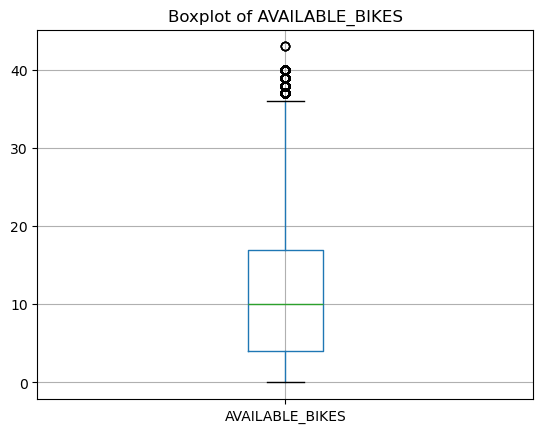

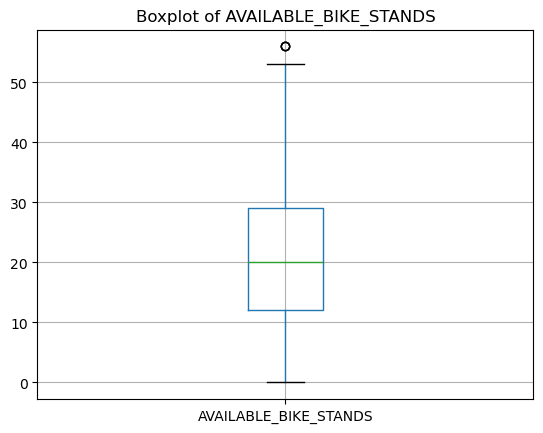

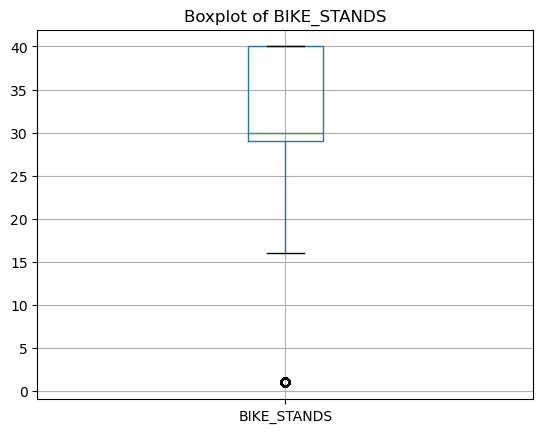

In [8]:
import matplotlib.pyplot as plt
# We are plotting boxplot to understand the outliers so that we can decide how should we handle the missing values? 
bikes.boxplot(column='AVAILABLE_BIKES')
plt.title('Boxplot of AVAILABLE_BIKES')
plt.show()

bikes.boxplot(column='AVAILABLE_BIKE_STANDS')
plt.title('Boxplot of AVAILABLE_BIKE_STANDS')
plt.show()

bikes.boxplot(column='BIKE_STANDS')
plt.title('Boxplot of BIKE_STANDS')
plt.show()

In [9]:
# Cleaning
print(f"Shape before cleaning: {bikes.shape}")
bikes = bikes.drop_duplicates(keep='first')
bikes = bikes.sort_values(['STATION ID', 'TIME'])
bikes[['AVAILABLE_BIKES', 'AVAILABLE_BIKE_STANDS']] = bikes.groupby('STATION ID')[
    ['AVAILABLE_BIKES', 'AVAILABLE_BIKE_STANDS']
].ffill()
# For each station, forward fills missing values wheer each NaN value takes the last known valye for that station
# This helps is preserving continuity and avoids filling the first station's gap with the second's values

bikes = bikes.dropna(subset=['AVAILABLE_BIKES'])

# Feature engineering
bikes['occupancy_rate'] = (bikes['AVAILABLE_BIKES'] / bikes['BIKE_STANDS']).clip(0, 1) # forcing the value to remain between 0-1 inacse of inconsistencies

print(f"Shape after cleaning: {bikes.shape}")
print(bikes.info(memory_usage='deep'))
print(bikes[['occupancy_rate']].describe())

Shape before cleaning: (36186600, 11)
Shape after cleaning: (36186600, 12)
<class 'pandas.core.frame.DataFrame'>
Index: 36186600 entries, 15942577 to 12653642
Data columns (total 12 columns):
 #   Column                 Dtype         
---  ------                 -----         
 0   STATION ID             int32         
 1   TIME                   datetime64[ns]
 2   LAST UPDATED           datetime64[ns]
 3   NAME                   object        
 4   BIKE_STANDS            int64         
 5   AVAILABLE_BIKE_STANDS  int64         
 6   AVAILABLE_BIKES        int64         
 7   STATUS                 object        
 8   ADDRESS                object        
 9   LATITUDE               float32       
 10  LONGITUDE              float32       
 11  occupancy_rate         float64       
dtypes: datetime64[ns](2), float32(2), float64(1), int32(1), int64(3), object(3)
memory usage: 8.5 GB
None
       occupancy_rate
count    3.618660e+07
mean     3.662868e-01
std      2.869785e-01
min      0.

In [10]:
# We are filling the missing data in these object columns with a placeholder - 'unknown'
bikes['ADDRESS'] = bikes['ADDRESS'].fillna('Unknown')
bikes['NAME'] = bikes['NAME'].fillna('Unknown')
bikes['STATUS'] = bikes['STATUS'].fillna('Unknown')

# Future improvements 
    # If we later convert these columns to category dtype, add "Unknown" as an explicit category first (for memory and modeling efficiency).
    # Consider whether STATUS can be forward-filled by station and time (since station status tends to persist until changed), then only use "Unknown" for remaining gaps.

In [11]:
# Count violations
print(f"Negative bikes: {(bikes['AVAILABLE_BIKES'] < 0).sum()}")
print(f"Bikes > stands: {(bikes['AVAILABLE_BIKES'] > bikes['BIKE_STANDS']).sum()}")

# Cap AVAILABLE_BIKES at BIKE_STANDS
bikes['AVAILABLE_BIKES'] = bikes['AVAILABLE_BIKES'].clip(lower=0, upper=bikes['BIKE_STANDS']) # lowest value = 0 ; highest = no. of bike stands
bikes['AVAILABLE_BIKE_STANDS'] = bikes['AVAILABLE_BIKE_STANDS'].clip(lower=0, upper=bikes['BIKE_STANDS'])

print(f"Final shape after cleaning: {bikes.shape}")
print(bikes.info())

Negative bikes: 0
Bikes > stands: 852
Final shape after cleaning: (36186600, 12)
<class 'pandas.core.frame.DataFrame'>
Index: 36186600 entries, 15942577 to 12653642
Data columns (total 12 columns):
 #   Column                 Dtype         
---  ------                 -----         
 0   STATION ID             int32         
 1   TIME                   datetime64[ns]
 2   LAST UPDATED           datetime64[ns]
 3   NAME                   object        
 4   BIKE_STANDS            int64         
 5   AVAILABLE_BIKE_STANDS  int64         
 6   AVAILABLE_BIKES        int64         
 7   STATUS                 object        
 8   ADDRESS                object        
 9   LATITUDE               float32       
 10  LONGITUDE              float32       
 11  occupancy_rate         float64       
dtypes: datetime64[ns](2), float32(2), float64(1), int32(1), int64(3), object(3)
memory usage: 3.1+ GB
None


In [12]:
# Checking the station counts and uniqueness
print(bikes['NAME'].nunique())         # Number of unique stations
print(bikes['STATION ID'].nunique())   

# the count matches the station names. Hence we can conclude that the data is consistent

118
118


In [13]:
bikes.head()
# Since 'NAME' and 'ADDRESS' column have the same data, we will drop the name column

,STATION ID,TIME,LAST UPDATED,NAME,BIKE_STANDS,AVAILABLE_BIKE_STANDS,AVAILABLE_BIKES,STATUS,ADDRESS,LATITUDE,LONGITUDE,occupancy_rate
15942577,1,2019-01-01 00:00:03,2018-12-31 23:50:05,CLARENDON ROW,31,30,1,Open,Clarendon Row,53.340927,-6.262501,0.032258
15942578,1,2019-01-01 00:05:03,2019-01-01 00:00:14,CLARENDON ROW,31,30,1,Open,Clarendon Row,53.340927,-6.262501,0.032258
15942579,1,2019-01-01 00:10:02,2019-01-01 00:00:14,CLARENDON ROW,31,30,1,Open,Clarendon Row,53.340927,-6.262501,0.032258
15942580,1,2019-01-01 00:15:02,2019-01-01 00:10:24,CLARENDON ROW,31,30,1,Open,Clarendon Row,53.340927,-6.262501,0.032258
15942581,1,2019-01-01 00:20:01,2019-01-01 00:10:24,CLARENDON ROW,31,30,1,Open,Clarendon Row,53.340927,-6.262501,0.032258


In [14]:
# Dropping the 'NAME' column
bikes.drop('NAME', axis=1, inplace=True, errors='ignore') 
# axis = 1 = columns
# inplace = True means that we're making the change in the original dataframe
# since we're running the code multiple times and if the column does not exist in our data frame, we have used errors='ignore' to just skip it and not raise an error incase 'NAME' is not found 
bikes.head()

,STATION ID,TIME,LAST UPDATED,BIKE_STANDS,AVAILABLE_BIKE_STANDS,AVAILABLE_BIKES,STATUS,ADDRESS,LATITUDE,LONGITUDE,occupancy_rate
15942577,1,2019-01-01 00:00:03,2018-12-31 23:50:05,31,30,1,Open,Clarendon Row,53.340927,-6.262501,0.032258
15942578,1,2019-01-01 00:05:03,2019-01-01 00:00:14,31,30,1,Open,Clarendon Row,53.340927,-6.262501,0.032258
15942579,1,2019-01-01 00:10:02,2019-01-01 00:00:14,31,30,1,Open,Clarendon Row,53.340927,-6.262501,0.032258
15942580,1,2019-01-01 00:15:02,2019-01-01 00:10:24,31,30,1,Open,Clarendon Row,53.340927,-6.262501,0.032258
15942581,1,2019-01-01 00:20:01,2019-01-01 00:10:24,31,30,1,Open,Clarendon Row,53.340927,-6.262501,0.032258


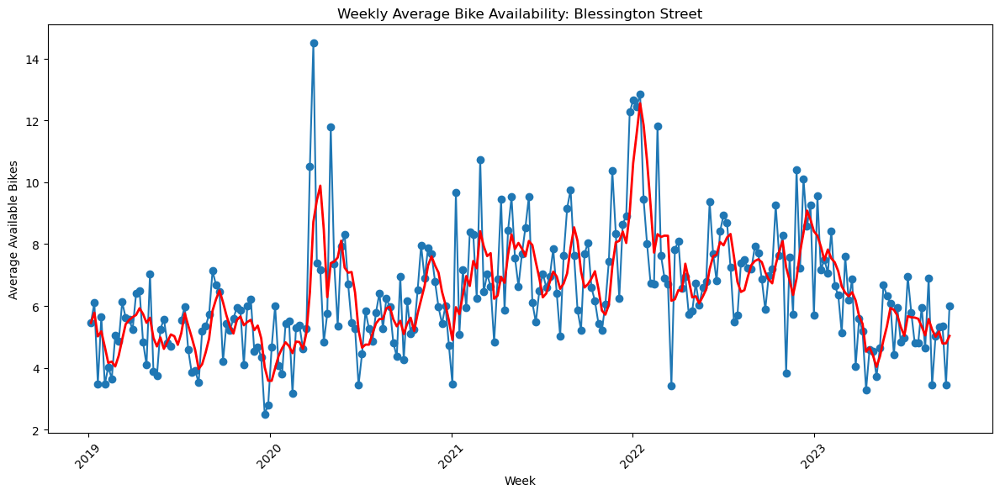

In [15]:
# Time series plot of bike availability for one selected station - blessington streeet

# Plotting every single reading crowded the graph and made it hard to read. 
# Hence we decided to calculate the availability per week instead of per month for a shorter interval which helps us to see the trends better

# Filter to one station, e.g. Blessington Street id is 2
station_df = bikes[bikes['STATION ID'] == 2].copy()

# Make sure TIME is datetime
station_df['TIME'] = pd.to_datetime(station_df['TIME'])

# Aggregate by week - Adding a rolling mean to smooth the noise and highlight trend
weekly_availability = station_df.resample('W', on='TIME')['AVAILABLE_BIKES'].mean() # weekly bins -> each week gets the avg. aval bikes
weekly_availability_rolling = weekly_availability.rolling(window=4, min_periods=1).mean()

# time series plot
import matplotlib.pyplot as plt
plt.figure(figsize=(12,6))
plt.plot(weekly_availability.index, weekly_availability.values, marker='o', label = 'weekly mean')
plt.plot(weekly_availability_rolling.index, weekly_availability_rolling.values,
         color='red', linewidth=2, label='4-week rolling mean')
plt.title('Weekly Average Bike Availability: Blessington Street')
plt.xlabel('Week')
plt.ylabel('Average Available Bikes')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

INSIGHTS: 
* each point is the avg of the last 4 weeks(or fewer at the start)
* red line - the rolling mean smooths the noise and highlights longer trends
* blue line - raw weekly avg of bikes available
* a steep increase in 2020 - could be because of lockdown
* steep decrese in 2022 - could be due to people returning back to work post lockdown
* and a more balanced distribution post 2022 just like in 2019

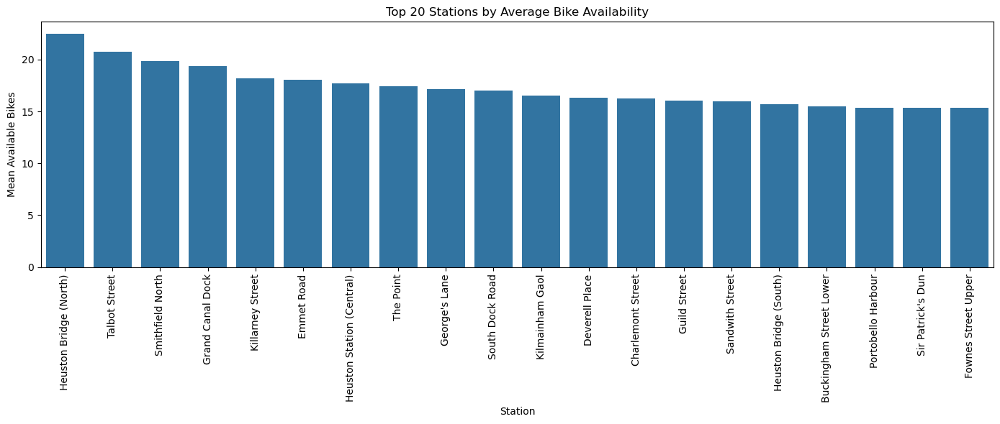

In [16]:
# Station-Level Summary: Mean Availability Per Station (Bar Plot Top 20)
import seaborn as sns

# Aggregate mean availability per station
station_avgs = (
    bikes.groupby(['STATION ID', 'ADDRESS'])['AVAILABLE_BIKES']
    .mean()
    .sort_values(ascending=False)  
)

plt.figure(figsize=(14, 6))
top20 = station_avgs.head(20)
sns.barplot(x=top20.index.get_level_values('ADDRESS'),
            y=top20.values)
plt.title('Top 20 Stations by Average Bike Availability')
plt.ylabel('Mean Available Bikes')
plt.xlabel('Station')
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()


In [30]:
# Baseline model - Quartile-Based Segmentation - pd.qcut
# Occupancy rate per row(every record)
bikes['occupancy_rate'] = (bikes['AVAILABLE_BIKES'] / bikes['BIKE_STANDS']).clip(0, 1)

# Avg occupancy rate per station
station_occupancy = bikes.groupby('ADDRESS')['occupancy_rate'].mean().reset_index()

# Defining quartile labels
quartile_labels = ['Q1 (Very low)', 'Q2 (Low)', 'Q3 (High)', 'Q4 (Very high)']

# Create the quartile-based group
station_occupancy['quartile_segment'] = pd.qcut(
    station_occupancy['occupancy_rate'],
    q=4,  # number of groups
    labels=quartile_labels,
    duplicates='drop'  # in case of many ties
)

print(station_occupancy[['ADDRESS', 'occupancy_rate', 'quartile_segment']].head())

              ADDRESS  occupancy_rate quartile_segment
0       Avondale Road        0.281356         Q2 (Low)
1       Barrow Street        0.465870   Q4 (Very high)
2       Benson Street        0.295024         Q2 (Low)
3     Blackhall Place        0.511288   Q4 (Very high)
4  Blessington Street        0.315747         Q2 (Low)


In [18]:
n_names = bikes['ADDRESS'].nunique()
n_ids = bikes['STATION ID'].nunique()
print(f"Unique station IDs: {n_ids}, unique addresses: {n_names}")

#The data is consistent

Unique station IDs: 118, unique addresses: 118


# PROBLEM STATEMENT - to group the bike stations into different categories based on their occupancy rates and identify patterns among high and low usage stations

## OUR GOAL:
* To understand the bike usage pattern across all stations by assigning eash station to a cluster revealing its avg. occupancy
* To provide insights into which stations are underused, overused, or balanced which coul help in redistribution and planning

## FEATURES FOR CLUSTERING
1. 'occupancy_rate'
2. 'BIKE_STANDS'
3. 'AVAILABLE_BIKES'

## Model we plan to use - KMeans Clustering for exploratory grouping
* We have chosen KMeans because it is computationally efficient even with large datasets like ours
* Since all the features we've considered are numeric, it is well suited for KMeans
* Works well to find centroids
* We can have clear interpretations since each cluster corresponds to a pattern(the occupancy category)

## SUCCESS METRICS
1. silhouette score - how well seperated are the clusters?

In [19]:
import pandas as pd
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler

# 1. Occupancy rate per record
bikes['occupancy_rate'] = (bikes['AVAILABLE_BIKES'] / bikes['BIKE_STANDS']).clip(0, 1)

# 2. Station-level aggregation
station_usage = bikes.groupby('STATION ID').agg({
    'occupancy_rate': 'mean','BIKE_STANDS': 'mean'}).reset_index()

# 3. Features for clustering
features = ['occupancy_rate', 'BIKE_STANDS']
X = station_usage[features]

# 4. Scale features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

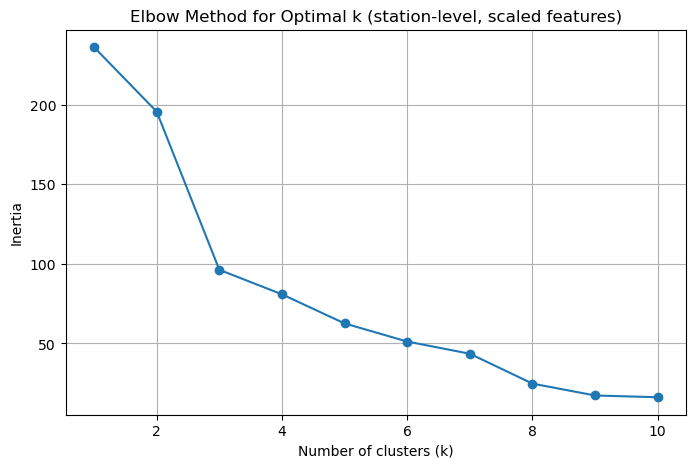

In [20]:
inertia_values = []
K = range(1, 11)

for i in K:
    kmeans = KMeans(n_clusters=i, random_state=42)
    kmeans.fit(X_scaled)
    inertia_values.append(kmeans.inertia_)

plt.figure(figsize=(8, 5))
plt.plot(K, inertia_values, marker='o')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Inertia')  # within-cluster sum of squares
plt.title('Elbow Method for Optimal k (station-level, scaled features)')
plt.grid(True)
plt.show()

INSIGHTS:
* Based on the elbow plot we can see that the inertia starts to drop sharply at k=2 to k=3 to k=4 and then the slope kinda flattens at k=4.
* The best k is when the change happens and since the slope flattens at k=4, we will consider 4 clusters.
* Namely - 'Low', 'Moderate', 'High', 'Very High'

### Using the "Elbow method" to find the optimal number of clusters based on the occupancy rate

In [21]:
# 5. Fit final KMeans on scaled data (choose k from elbow, e.g. k=4)
k_opt = 4
kmeans_final = KMeans(n_clusters=k_opt, random_state=42)
station_usage['cluster'] = kmeans_final.fit_predict(X_scaled)
print(f"Number of clusters formed : {station_usage['cluster'].nunique()}")

# 6. calculating silhouette score on same scaled data - measures how well the clusters are seperated
sil_score = silhouette_score(X_scaled, station_usage['cluster'])
print(f"Silhouette score for k={k_opt}: {sil_score:.3f}")

# 7. Order clusters by centroid occupancy and assign human-readable labels
centers = kmeans_final.cluster_centers_  # shape (k, 2) for [occupancy_rate, BIKE_STANDS]
occupancy_centers = centers[:, 0]       # first column = occupancy_rat 

order = occupancy_centers.argsort()      # from lowest to highest
labels_ordered = ['Low', 'Moderate', 'High', 'Very High']  

label_map = {}
for rank, cluster_id in enumerate(order):
    label_map[cluster_id] = labels_ordered[rank]

station_usage['cluster_label'] = station_usage['cluster'].map(label_map)

print(station_usage[['STATION ID', 'occupancy_rate', 'BIKE_STANDS',
                     'cluster', 'cluster_label']].head())

Number of clusters formed : 4
Silhouette score for k=4: 0.408
   STATION ID  occupancy_rate  BIKE_STANDS  cluster cluster_label
0           1        0.389213         31.0        3      Moderate
1           2        0.315747         20.0        2          High
2           3        0.359423         20.0        2          High
3           4        0.446547         20.0        2          High
4           5        0.407114         40.0        1           Low


INSIGHTS:
* Silhouette score of 0.40 mean moderately well seperated clusters

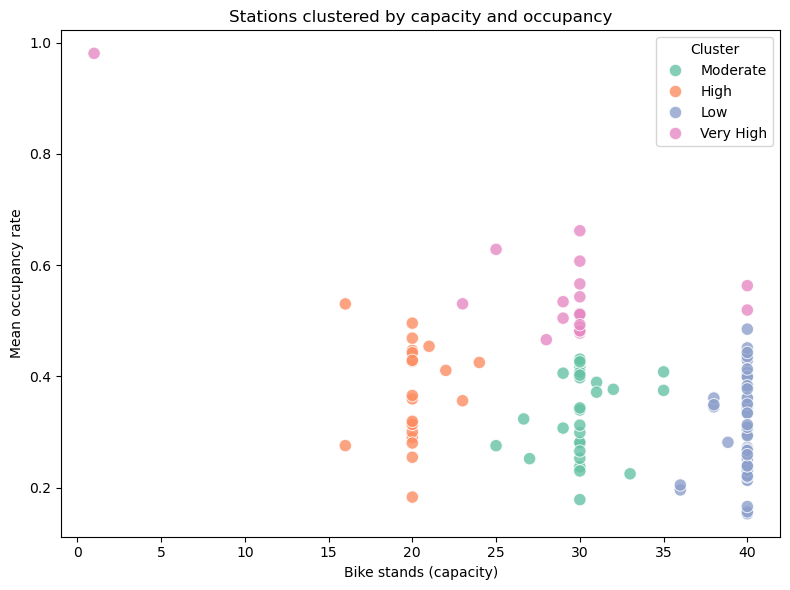

In [22]:
# visual insights
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 6))
sns.scatterplot(
    data=station_usage,
    x='BIKE_STANDS',
    y='occupancy_rate',
    hue='cluster_label',        # colour by our labels
    palette='Set2',
    s=80,
    alpha=0.8
)
plt.xlabel('Bike stands (capacity)')
plt.ylabel('Mean occupancy rate')
plt.title('Stations clustered by capacity and occupancy')
plt.legend(title='Cluster')
plt.tight_layout()
plt.show()

In [23]:
# Avg occupancy rate per station
station_occupancy = bikes.groupby('STATION ID')['occupancy_rate'].mean().reset_index()
print(station_occupancy)

     STATION ID  occupancy_rate
0             1        0.389213
1             2        0.315747
2             3        0.359423
3             4        0.446547
4             5        0.407114
..          ...             ...
113         114        0.259149
114         115        0.607037
115         116        0.265691
116         117        0.165980
117         507        0.980607

[118 rows x 2 columns]


In [24]:
# Dividing the occupancy rate data into 4 categories by calculating the quantiles
occupancy_rate_quantiles = bikes['occupancy_rate'].quantile([0, 0.25, 0.50, 0.75, 1.0])
# These quantiles give us information and a comparative baseline against KMeans

# Creating a list containing description of each band and its min/max occupancy rate
cluster_info = []
quartile_labels = ['Very low', 'Low', 'High', 'Very high']

for i in range(4):
    cluster_info.append({
        'Quartile band': quartile_labels[i],
        'Min occupancy rate': occupancy_rate_quantiles.iloc[i],
        'Max occupancy rate': occupancy_rate_quantiles.iloc[i+1]
    })

cluster_info_dataframe = pd.DataFrame(cluster_info)
print(cluster_info_dataframe)

  Quartile band  Min occupancy rate  Max occupancy rate
0      Very low            0.000000            0.125000
1           Low            0.125000            0.315789
2          High            0.315789            0.552632
3     Very high            0.552632            1.000000


The clusters have been divided based on the occupancy rate

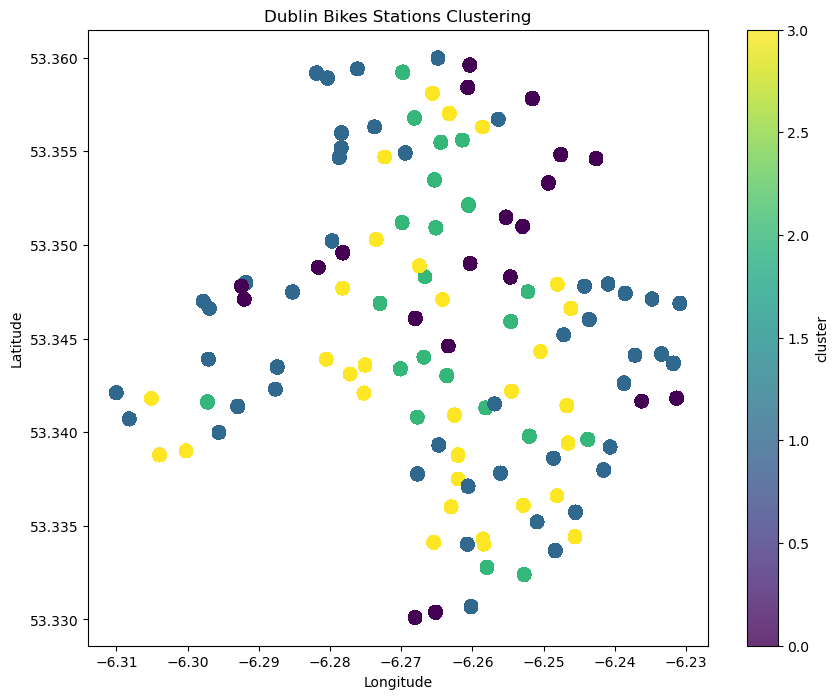

In [25]:
cluster_info = station_usage[['STATION ID', 'cluster', 'cluster_label']]
bikes = bikes.merge(
    cluster_info,
    on='STATION ID',
    how='left'
)

# Ploting the scatter plot for clusters
plt.figure(figsize=(10, 8))
scatter = plt.scatter(
    bikes['LONGITUDE'],
    bikes['LATITUDE'],
    c=bikes['cluster'],
    s=80,
    alpha=0.8,
)
plt.colorbar(scatter, label='cluster')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Dublin Bikes Stations Clustering')
plt.show()

#### Why and how folium is used in the study: 
- Folium is a python library which is used to create intereactive maps using geaographical coordinates.
- In our study the folium is used to transform the clusterd data from the dublinbike dataframe into an interactive web based  map visualization.
- Each bike station loacation is geographically marked on the dublin map with highlighting the name of the bike station and the level of occupancy.
- Each station location is marked with a color based on the occupancy level cluster.
- This technique make it easy to visualize the data on the map of dublin.

In [26]:
import matplotlib.colors as mcolors
import folium
from branca.element import IFrame
from sklearn.metrics import silhouette_score

In [27]:
# Loading the dublin geographical map
map_center = [bikes['LATITUDE'].median(), bikes['LONGITUDE'].median()]
dublin_map = folium.Map(location=map_center, zoom_start=13)

# Sampling the dublin bike data set for faster execution
df_sample = bikes.sample(n=20000, random_state=42)

# Preparing cluster colors using the cluster number
clusters = sorted(df_sample['cluster'].unique())
cmap = plt.get_cmap('viridis')

# Mapping the colors to the cluster numbers
colors = {}
for i, cluster in enumerate(clusters):
    colors[cluster] = mcolors.rgb2hex(cmap(i/(len(clusters)-1)))

print(colors)

{0: '#440154', 1: '#31688e', 2: '#35b779', 3: '#fde725'}


In [28]:
# Ploting the bike stations on Dublin map
for _,station_detail in df_sample.iterrows():
    station_name = station_detail['ADDRESS']
    occupancy_level = station_detail['cluster_label']
    cluster_number = station_detail['cluster']
    folium.CircleMarker(
        location = [station_detail['LATITUDE'],station_detail['LONGITUDE']],
        radius = 4,
        color = colors[cluster_number],
        popup = f"Station Name : {station_name} <br> Busy Level : {occupancy_level} ",
        fill = True,
        fill_color = colors[cluster_number],
        fill_opacity = 0.8
    ).add_to(dublin_map)
dublin_map